Autor:
Manuel Eugenio Morocho Cayamcela, PhD

# **Aprendizaje Supervisado**

## Regresión Lineal Simple - Cálculo e Interpretación Paso a Paso

## ¿Qué es la regresión lineal simple?

Es un método estadístico que nos permite encontrar una **relación lineal entre dos variables**:

- Una **variable independiente** $ X $ (por ejemplo: horas de estudio)
- Una **variable dependiente** $ Y $ (por ejemplo: nota en el examen)

El modelo tiene esta forma:

$
Y = \beta_0 + \beta_1 X
$

Donde:

- $ \beta_0 $: es la **intersección (intercepto)**. Es el valor de $ Y $ cuando $ X = 0 $.  
- $ \beta_1 $: es la **pendiente de la recta**, y representa cuánto cambia $ Y $ por cada unidad que aumenta $ X $.


## ¿De dónde salen las fórmulas?

Queremos encontrar una recta que se ajuste lo mejor posible a nuestros datos. Esa recta tiene la forma:

$
\hat{y}_i = \beta_0 + \beta_1 x_i
$

Donde $ \hat{y}_i $ es el valor predicho, y $ y_i $ el valor real observado.

### ¿Qué significa "mejor ajuste"?

Queremos que los errores entre lo real y lo predicho sean lo más pequeños posible:

$
\text{Error}_i = y_i - \hat{y}_i = y_i - (\beta_0 + \beta_1 x_i)
$

Para evitar que los errores se cancelen (positivos con negativos), los **elevamos al cuadrado**. Así, minimizamos el siguiente error total:

$
\text{ECM} = \sum_{i=1}^{n} (y_i - \beta_0 - \beta_1 x_i)^2
$

Este es el criterio de **mínimos cuadrados**.

### ¿Cómo se minimiza?

Usamos cálculo: derivamos la función de error respecto a los parámetros y resolvemos:

1. Derivada respecto a $ \beta_0 $:

$
\frac{\partial}{\partial \beta_0} \sum (y_i - \beta_0 - \beta_1 x_i)^2 = 0
$

2. Derivada respecto a $ \beta_1 $:

$
\frac{\partial}{\partial \beta_1} \sum (y_i - \beta_0 - \beta_1 x_i)^2 = 0
$

Estas dos ecuaciones (llamadas ecuaciones normales) se resuelven para obtener:

$
\beta_1 = \frac{\sum (x_i - \bar{x})(y_i - \bar{y})}{\sum (x_i - \bar{x})^2}
$
$
\beta_0 = \bar{y} - \beta_1 \bar{x}
$



## Paso a Paso con un Ejemplo Numérico

### Datos

| X (Horas de estudio) | Y (Nota) |
|----------------------|----------|
| 1                    | 3        |
| 2                    | 5        |
| 3                    | 7        |



### Calcular los promedios

$
\bar{X} = \frac{1 + 2 + 3}{3} = 2
$
$
\bar{Y} = \frac{3 + 5 + 7}{3} = 5
$



### Calcular la pendiente $ \beta_1 $

$
\beta_1 = \frac{\sum (x_i - \bar{x})(y_i - \bar{y})}{\sum (x_i - \bar{x})^2}
$

| X | Y | $X - \bar{X}$ | $Y - \bar{Y}$ | $(X - \bar{X})(Y - \bar{Y})$ | $(X - \bar{X})^2$ |
|---|---|------------------|------------------|--------------------------------|----------------------|
| 1 | 3 | -1               | -2               | 2                              | 1                    |
| 2 | 5 | 0                | 0                | 0                              | 0                    |
| 3 | 7 | 1                | 2                | 2                              | 1                    |

$
\beta_1 = \frac{2 + 0 + 2}{1 + 0 + 1} = \frac{4}{2} = 2
$



### Calcular el intercepto $ \beta_0 $

$
\beta_0 = \bar{Y} - \beta_1 \bar{X} = 5 - 2 \cdot 2 = 1
$



### Ecuación final de la recta

$
Y = 1 + 2X
$



## Interpretación

- **Intercepto $ \beta_0 = 1 $**: si no estudias nada (X = 0), la predicción de tu nota es 1.
- **Pendiente $ \beta_1 = 2 $**: por cada **hora adicional de estudio**, se espera que la nota aumente en **2 puntos**.

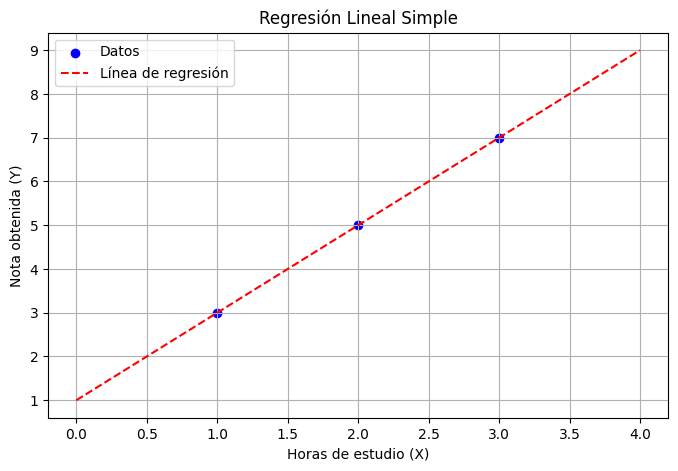

In [1]:
## Visualización con Python
import matplotlib.pyplot as plt

# Datos
X = [1, 2, 3]
Y = [3, 5, 7]

# Coeficientes calculados
beta_0 = 1
beta_1 = 2

# Recta de regresión
X_line = [0, 4]
Y_line = [beta_0 + beta_1 * x for x in X_line]

# Gráfico
plt.figure(figsize=(8, 5))
plt.scatter(X, Y, color='blue', label='Datos')
plt.plot(X_line, Y_line, color='red', linestyle='--', label='Línea de regresión')
plt.xlabel('Horas de estudio (X)')
plt.ylabel('Nota obtenida (Y)')
plt.title('Regresión Lineal Simple')
plt.legend()
plt.grid(True)
plt.show()

## Predicción de Gastos Médicos para una Aseguradora usando Regresión Lineal Múltiple

### **Introducción:** 
En esta actividad, exploraremos el concepto de regresión lineal utilizando la base de datos `insurance.csv`. La regresión lineal es una técnica de aprendizaje supervisado que se utiliza para predecir el valor de una variable dependiente (en este caso, `charges`, basada en una o más variables independientes (por ejemplo, `age`, `bmi`, `children`, etc.).

Puedes descargar la base de datos desde [acá](https://www.kaggle.com/datasets/mirichoi0218/insurance?resource=download).

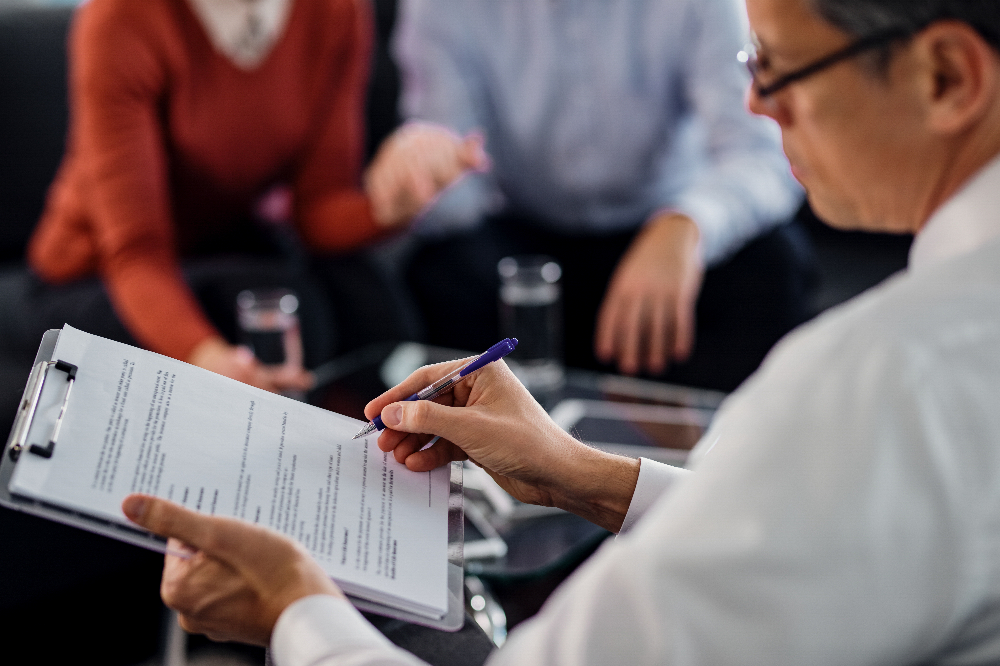

La base de datos `insurance.csv` contiene información sobre individuos y sus cargos médicos. A continuación se describe cada una de las variables presentes en el archivo:

1. **age**: Edad del individuo (en años).
2. **sex**: Sexo del individuo (male para masculino y female para femenino).
3. **bmi**: Índice de Masa Corporal (IMC) del individuo, una medida del peso en relación con la altura.
4. **children**: Número de hijos o dependientes que tiene el individuo.
5. **smoker**: Indica si el individuo es fumador (yes para sí y no para no).
6. **region**: Región geográfica en la que reside el individuo (northeast, northwest, southeast, southwest).
7. **charges**: Cargos médicos totales facturados al individuo (en dólares).

Estas variables se utilizan comúnmente para analizar y predecir los costos médicos en función de las características demográficas y de salud de los individuos.


### **Contenido:**

#### Importamos los paquetes necesarios

In [2]:
# Instalamos los paquetes necesarios
%pip install scikit-learn # Paquete de machine learning con algoritmos de clasificación, regresión, clustering, etc.
%pip install pandas
%pip install matplotlib
%pip install seaborn

# Importamos los paquetes necesarios
from sklearn.linear_model import LinearRegression # Regresión lineal con scikit-learn
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

Note: you may need to restart the kernel to use updated packages.


ERROR: Invalid requirement: '#': Expected package name at the start of dependency specifier
    #
    ^


Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.




#### Cargamos la base de datos


In [4]:
# Cargamos la base de datos 'insurance.csv'
insurance = pd.read_csv('D:/Maestria_AI/Actividad 6/insurance.csv')

# Visualizamos las primeras 10 filas de la base de datos cargada
insurance.head(10)

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
5,31,female,25.740,0,no,southeast,3756.62160
6,46,female,33.440,1,no,southeast,8240.58960
7,37,female,27.740,3,no,northwest,7281.50560
8,37,male,29.830,2,no,northeast,6406.41070
9,60,female,25.840,0,no,northwest,28923.13692


In [5]:
# Imprimimos los valores únicos de 'region' 
insurance['region'].unique()

array(['southwest', 'southeast', 'northwest', 'northeast'], dtype=object)

#### Preprocesamiento de datos

In [6]:
# Codificamos las variables categóricas 'sex' y 'smoker' con un reemplazo de etiquetas (label encoding)
insurance['sex'] = insurance['sex'].replace({'female': 0, 'male': 1})
insurance['smoker'] = insurance['smoker'].replace({'no': 0, 'yes': 1})

#Codificamos la variable 'region' y eliminamos la primera columna (one-hot encoding)
insurance = pd.get_dummies(insurance, columns=['region'], dtype=int)

# Visualizamos las primeras 10 filas después del preprocesamiento
insurance.head(10)

C:\Users\User\AppData\Local\Temp\ipykernel_18208\1607253937.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  insurance['sex'] = insurance['sex'].replace({'female': 0, 'male': 1})
C:\Users\User\AppData\Local\Temp\ipykernel_18208\1607253937.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  insurance['smoker'] = insurance['smoker'].replace({'no': 0, 'yes': 1})


,age,sex,bmi,children,smoker,charges,region_northeast,region_northwest,region_southeast,region_southwest
0,19,0,27.900,0,1,16884.92400,0,0,0,1
1,18,1,33.770,1,0,1725.55230,0,0,1,0
2,28,1,33.000,3,0,4449.46200,0,0,1,0
3,33,1,22.705,0,0,21984.47061,0,1,0,0
4,32,1,28.880,0,0,3866.85520,0,1,0,0
5,31,0,25.740,0,0,3756.62160,0,0,1,0
6,46,0,33.440,1,0,8240.58960,0,0,1,0
7,37,0,27.740,3,0,7281.50560,0,1,0,0
8,37,1,29.830,2,0,6406.41070,1,0,0,0
9,60,0,25.840,0,0,28923.13692,0,1,0,0


#### Preparamos las variables `X` y `y`

In [7]:
# Seleccionamos las variable independiente (X)
X = insurance.drop('charges', axis=1)
X

,age,sex,bmi,children,smoker,region_northeast,region_northwest,region_southeast,region_southwest
0,19,0,27.900,0,1,0,0,0,1
1,18,1,33.770,1,0,0,0,1,0
2,28,1,33.000,3,0,0,0,1,0
3,33,1,22.705,0,0,0,1,0,0
4,32,1,28.880,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...
1333,50,1,30.970,3,0,0,1,0,0
1334,18,0,31.920,0,0,1,0,0,0
1335,18,0,36.850,0,0,0,0,1,0
1336,21,0,25.800,0,0,0,0,0,1


In [8]:
# Seleccionamos la variable dependiente (y)
y = insurance['charges']
y

0       16884.92400
1        1725.55230
2        4449.46200
3       21984.47061
4        3866.85520
           ...     
1333    10600.54830
1334     2205.98080
1335     1629.83350
1336     2007.94500
1337    29141.36030
Name: charges, Length: 1338, dtype: float64

#### Dividimos los datos en conjuntos de entrenamiento y prueba

In [9]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

#### Instanciamos un modelo de Regresión Lineal y lo ajustamos con los valores de `X_train` y `y_train`

In [10]:
# Creamos una instancia del modelo de regresión lineal
modelo_regresion = LinearRegression()

# Ajustamos el modelo a los datos de entrenamiento
modelo_regresion.fit(X_train, y_train)

,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


##### **(Opcional)** Guardamos el modelo en formato .pkl

El formato `.pkl` es una extensión de archivo utilizada para almacenar objetos serializados en Python mediante el módulo `pickle`. Este módulo permite convertir objetos de Python en una secuencia de bytes, lo que facilita su almacenamiento en archivos o su transmisión a través de redes. Los archivos `.pkl` son comúnmente utilizados para guardar modelos entrenados en aprendizaje automático, estructuras de datos complejas, o cualquier otro objeto que necesite ser persistido entre sesiones de ejecución de un programa. La deserialización de estos archivos permite restaurar los objetos a su estado original, manteniendo su estructura y datos intactos.

In [11]:
# Guardamos el modelo para usarlo en el futuro
import joblib
joblib.dump(modelo_regresion, 'modelo_regresion.pkl')

['modelo_regresion.pkl']

##### **(Opcional)** Cargamos el modelo en formato .pkl

In [12]:
# Cargamos el modelo guardado
modelo_regresion = joblib.load('modelo_regresion.pkl')

#### Obtenemos los coeficientes y el intercepto del modelo de regresión

En el contexto de la regresión lineal, los coeficientes y el intercepto son parámetros fundamentales que definen la relación entre las variables independientes (predictoras) y la variable dependiente (respuesta).

##### *a) Coeficientes*
Los coeficientes (también conocidos como pesos o betas) representan la magnitud y la dirección de la relación entre cada variable independiente y la variable dependiente. En una ecuación de regresión lineal múltiple, cada coeficiente indica cuánto cambia la variable dependiente cuando la variable independiente correspondiente aumenta en una unidad, manteniendo constantes las demás variables independientes. Matemáticamente, si tenemos una ecuación de regresión lineal de la forma:

$y = \beta_0 + \beta_1 X_1 + \beta_2 X_2 + \ldots + \beta_n X_n$

donde:
- $y$ es la variable dependiente (objetivo).
- $\beta_0$ es el intercepto.
- $\beta_1, \beta_2, \ldots, \beta_n $ son los coeficientes de las variables independientes $X_1, X_2, \ldots, X_n$.

##### *b) Intercepto*
El intercepto $\beta_0$ es el valor de la variable dependiente cuando todas las variables independientes son iguales a cero. Representa el punto donde la recta de regresión cruza el eje $y$. En otras palabras, es el valor predicho de $y$ cuando no hay influencia de las variables independientes.

##### Ejemplo:
Si tenemos una ecuación de regresión lineal simple con dos variables independientes, podría verse así:

$y = 3 + 2X_1 - 4X_2$

En este caso:
- El intercepto $\beta_0$ es 3.
- El coeficiente de $X_1$ ($\beta_1$) es 2, lo que significa que por cada incremento de una unidad en $X_1$, $y$ aumenta en 2 unidades.
- El coeficiente de $X_2$ ($\beta_2$) es -4, lo que significa que por cada incremento de una unidad en $X_2$, $y$ disminuye en 4 unidades.

Estos parámetros son esenciales para interpretar el modelo de regresión lineal y entender cómo las variables independientes afectan la variable dependiente.

In [13]:
# Obtenemos los coeficientes 
coeficientes = modelo_regresion.coef_
coeficientes

array([  259.27991344,  -137.29729888,   336.01728964,   430.16955009,
       23869.12582694,   358.80134028,   220.53293786,  -316.76882105,
        -262.56545709])

In [14]:
# Obtenemos el intercepto 
intercepto = modelo_regresion.intercept_
intercepto

np.float64(-12530.75779220644)

In [15]:
# Definimos la ecuación de la recta de regresión
ecuacion_recta = 'y = ' + ' + '.join([f'{coeficientes[i]}*X{i}' for i in range(len(coeficientes))]) + f' + {intercepto}'
print(f'Ecuación de la recta de regresión: {ecuacion_recta}')

Ecuación de la recta de regresión: y = 259.27991344090975*X0 + -137.29729888138658*X1 + 336.0172896390925*X2 + 430.16955009264126*X3 + 23869.12582694413*X4 + 358.8013402815794*X5 + 220.532937855384*X6 + -316.7688210493754*X7 + -262.5654570875852*X8 + -12530.75779220644


Con la ecuación de la recta de regresión, podemos realizar predicciones sobre los cargos médicos basándonos en las características de entrada. Esta ecuación nos permite entender cómo cada característica influye en el resultado final, proporcionando una relación matemática clara entre las variables independientes (características) y la variable dependiente (cargos médicos). Al aplicar esta ecuación a nuevos datos, podemos estimar los cargos médicos esperados, lo cual es útil para análisis predictivos, toma de decisiones informadas y planificación de recursos en el ámbito de la salud. Además, la ecuación de la recta de regresión facilita la interpretación de los coeficientes, ayudándonos a identificar qué factores tienen mayor impacto en los costos médicos.

Con los datos de los coeficientes encontrados en la ecuación de la recta de regresión, podemos analizar la influencia de cada variable independiente en los costos médicos. Los coeficientes representan el cambio esperado en la variable dependiente (cargos médicos) por cada unidad de cambio en la variable independiente correspondiente, manteniendo constantes las demás variables.

Para determinar qué variables tienen mayor impacto en los costos médicos, podemos observar los valores absolutos de los coeficientes:

1. **Coeficientes más altos**: Indican que la variable asociada tiene un mayor impacto en los costos médicos. Un coeficiente alto significa que un pequeño cambio en esta variable resultará en un cambio significativo en los costos médicos.
2. **Coeficientes más bajos**: Indican que la variable asociada tiene un menor impacto en los costos médicos. Un coeficiente bajo significa que un cambio en esta variable resultará en un cambio menor en los costos médicos.

Además, el signo del coeficiente (positivo o negativo) nos indica la dirección de la relación entre la variable independiente y los costos médicos:

- **Coeficiente positivo**: Un aumento en la variable independiente está asociado con un aumento en los costos médicos.
- **Coeficiente negativo**: Un aumento en la variable independiente está asociado con una disminución en los costos médicos.

Analizando estos coeficientes, podemos identificar cuáles son las variables más influyentes y cómo afectan los costos médicos, lo que puede ser útil para la toma de decisiones y la planificación en el ámbito de la salud.

In [16]:
# Crear un DataFrame para facilitar la interpretación
coef_df = pd.DataFrame({'Variable': X.columns, 'Coeficiente': coeficientes})

# Ordenar por el valor absoluto del coeficiente para ver cuáles son más importantes
coef_df['Abs_Coeficiente'] = coef_df['Coeficiente'].abs()

# Ordenamos los coeficientes de mayor a menor
coef_df = coef_df.sort_values(by='Abs_Coeficiente', ascending=False)

print(coef_df)

           Variable   Coeficiente  Abs_Coeficiente
4            smoker  23869.125827     23869.125827
3          children    430.169550       430.169550
5  region_northeast    358.801340       358.801340
2               bmi    336.017290       336.017290
7  region_southeast   -316.768821       316.768821
8  region_southwest   -262.565457       262.565457
0               age    259.279913       259.279913
6  region_northwest    220.532938       220.532938
1               sex   -137.297299       137.297299


C:\Users\User\AppData\Local\Temp\ipykernel_18208\3043957422.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Coeficiente', y='Variable', data=coef_df, palette='coolwarm')


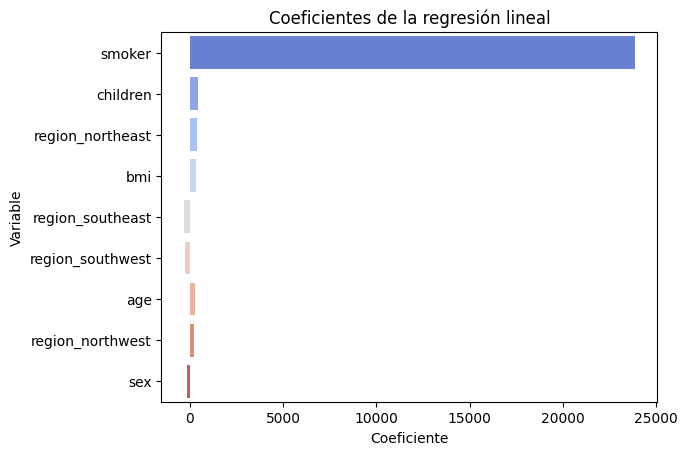

In [17]:
# Graficamos los coeficientes ordenados de mayor a menor en un gráfico de barras
sns.barplot(x='Coeficiente', y='Variable', data=coef_df, palette='coolwarm')

plt.xlabel('Coeficiente')
plt.ylabel('Variable')
plt.title('Coeficientes de la regresión lineal')
plt.show()

#### Calculamos las métricas de evaluación del modelo (haciendo predicciones sobre el conjunto de prueba)

En el contexto de la regresión lineal, es fundamental evaluar el rendimiento del modelo para entender su precisión y capacidad de generalización. Existen varias métricas de evaluación que nos ayudan a cuantificar el error y la calidad de las predicciones del modelo. Entre las más comunes se encuentran:

1. **Mean Squared Error (MSE)**: Esta métrica calcula el promedio de los cuadrados de los errores, es decir, la diferencia entre los valores predichos $\hat{y}_i$ y los valores reales $y_i$. El MSE penaliza fuertemente los errores grandes debido a la elevación al cuadrado, lo que lo convierte en una métrica sensible a los outliers. Un MSE más bajo indica un mejor ajuste del modelo a los datos. La fórmula del MSE es:
   
   $\text{MSE} = \frac{1}{n} \sum_{i=1}^{n} (y_i - \hat{y}_i)^2$
   
   donde $n$ es el número de observaciones.

2. **R-squared (R²)**: También conocido como coeficiente de determinación, esta métrica indica la proporción de la varianza en la variable dependiente que es explicada por las variables independientes del modelo. El valor de $R^2$ varía entre $0$ y $1$, donde un valor más cercano a $1$ indica que el modelo explica bien la variabilidad de los datos. Un $R^2$ de $0$ significa que el modelo no explica ninguna variabilidad, mientras que un $R^2$ de $1$ significa que el modelo explica toda la variabilidad. La fórmula del $R^2$ es:
   
   $R^2 = 1 - \frac{\sum_{i=1}^{n} (y_i - \hat{y}_i)^2}{\sum_{i=1}^{n} (y_i - \bar{y})^2}$
   
   donde $\bar{y}$ es el valor medio de los valores reales $y_i$.

3. **Mean Absolute Error (MAE)**: Esta métrica calcula el promedio de los errores absolutos, es decir, la diferencia absoluta entre los valores predichos $\hat{y}_i$ y los valores reales $y_i$. A diferencia del MSE, el MAE no penaliza tanto los errores grandes, lo que lo hace más robusto frente a outliers. Un MAE más bajo indica un mejor rendimiento del modelo. La fórmula del MAE es:
   
   $\text{MAE} = \frac{1}{n} \sum_{i=1}^{n} |y_i - \hat{y}_i|$
   
   donde $n$ es el número de observaciones.

Estas métricas proporcionan diferentes perspectivas sobre el rendimiento del modelo y, al utilizarlas en conjunto, se puede obtener una evaluación más completa y robusta de la calidad de las predicciones del modelo de regresión lineal.

In [18]:
# Realizamos predicciones sobre el conjunto de prueba
y_pred = modelo_regresion.predict(X_test)

# Importamos las métricas para evaluar el modelo
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Calculamos las métricas de evaluación
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Imprimimos las métricas de evaluación
print(f'Error Cuadrático Medio (MSE): {mse}')
print(f'Coeficiente de Determinación (R^2): {r2}')
print(f'Error Absoluto Medio (MAE): {mae}')

Error Cuadrático Medio (MSE): 36077869.003987625
Coeficiente de Determinación (R^2): 0.7224601674430706
Error Absoluto Medio (MAE): 3961.341098850965


#### Realizamos predicciones para un nuevo usuario de la aseguradora

In [19]:
# Definimos un nuevo caso de prueba con los siguientes valores
nuevo_caso = pd.DataFrame({
    'age': [30],  # Edad
    'sex': [1],  # Género (0: mujer, 1: hombre)
    'bmi': [19],  # Índice de masa corporal
    'children': [1],  # Número de hijos
    'smoker': [0],  # Fumador (0: no, 1: sí)
    'region_northeast': [0],  # Región noreste
    'region_northwest': [1],  # Región noroeste
    'region_southeast': [0],  # Región sureste
    'region_southwest': [0]  # Región suroeste
})

# Realizamos la predicción con el nuevo caso de prueba
prediccion = modelo_regresion.predict(nuevo_caso)

# Imprimimos el resultado de la predicción
print(f'El costo estimado del seguro médico es: ${prediccion[0]:.2f}')

El costo estimado del seguro médico es: $2145.37


En el caso de una regresión múltiple, donde tienes más de una variable independiente, la relación entre las variables independientes y la variable dependiente se representa en un **espacio de dimensiones superiores**. Por lo tanto, en lugar de una línea de regresión (que es aplicable en regresión simple con una sola variable independiente), tendrías un hiperplano en un espacio multidimensional.

Sin embargo, puedes visualizar la relación entre los valores reales y los valores predichos en un gráfico de dispersión, como se muestra a continuación. Este tipo de gráfico es útil para evaluar la precisión de las predicciones del modelo.

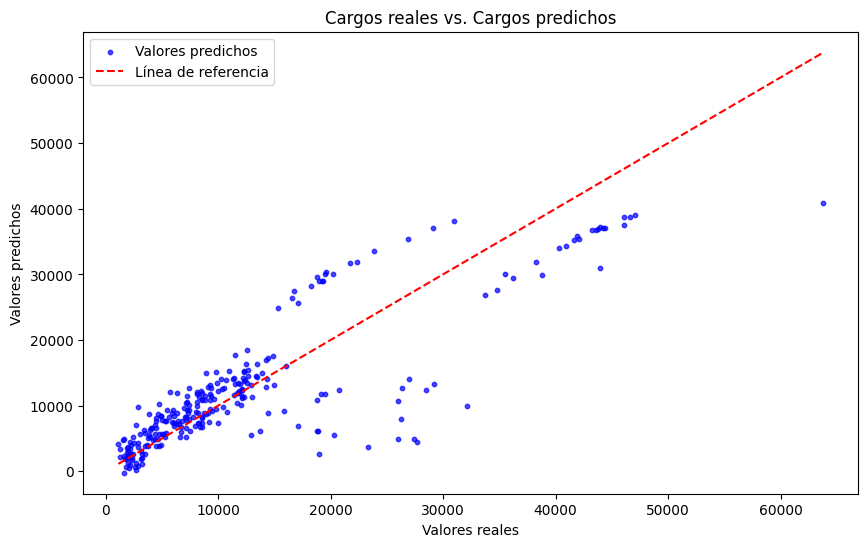

In [20]:
# Graficamos los valores reales vs los valores predichos
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.7, s=10)
plt.title('Cargos reales vs. Cargos predichos')
plt.xlabel('Valores reales')
plt.ylabel('Valores predichos')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--')  # Línea de referencia
plt.legend(['Valores predichos', 'Línea de referencia'])
plt.show()

En este gráfico:
- Los puntos azules representan los valores reales frente a los valores predichos.
- La línea roja discontinua es una línea de referencia que indica dónde estarían los puntos si las predicciones fueran perfectas (es decir, $y_{\text{real}} = y_{\text{predicho}}$).

Este gráfico te permite visualizar cómo de cerca están las predicciones de los valores reales. Si las predicciones son perfectas, todos los puntos caerán sobre la línea de referencia.

**Nota:** Los valores predichos negativos en un modelo de regresión lineal pueden ocurrir debido a la naturaleza de la ecuación de regresión, que no impone restricciones sobre el rango de los valores predichos. En el contexto de los cargos médicos, los valores negativos no tienen sentido práctico, ya que los costos médicos no pueden ser negativos.

Para abordar este problema, puedes considerar las siguientes opciones:

1. **Transformación de los datos**: Asegúrate de que las características y la variable objetivo estén adecuadamente transformadas y escaladas. A veces, una transformación logarítmica puede ayudar a manejar mejor los datos.

2. **Modelos con restricciones**: Utiliza modelos que impongan restricciones en los valores predichos, como la regresión lineal con restricciones (por ejemplo, `LinearRegression` con `positive=True` en `scikit-learn`).

3. **Post-procesamiento de las predicciones**: Después de realizar las predicciones, puedes ajustar los valores negativos a cero, ya que los costos médicos no pueden ser negativos.

## Regresión Lineal Simple

Como ejemplo, se puede ajustar una característica con una regresión lineal simple. Esto permitirá visualizar la relación entre una sola variable independiente y la variable dependiente.

Vamos a ajustar una regresión lineal simple utilizando una característica, por ejemplo, `bmi`.

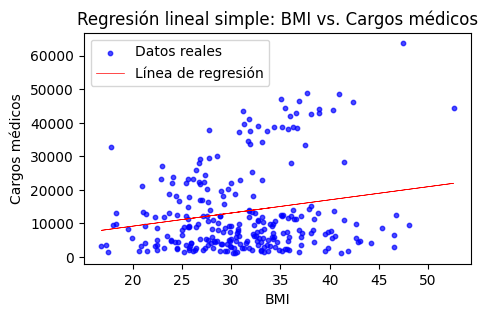

In [21]:
# Copio la base de datos 'insurance.csv' en un nuevo DataFrame
df = insurance.copy()

X_2 = df[['bmi']]
y_2 = df['charges']

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train2, X_test2, y_train2, y_test2 = train_test_split(X_2, y_2, test_size=0.2, random_state=42)

# Crear y entrenar el modelo de regresión lineal
model = LinearRegression()
model.fit(X_train2, y_train2)

# Realizar predicciones
y_pred = model.predict(X_test2)

# Graficar los datos y la línea de regresión
plt.figure(figsize=(5, 3))
plt.scatter(X_test2, y_test2, color='blue', alpha=0.7, s=10, label='Datos reales')
plt.plot(X_test2, y_pred, color='red', linewidth=0.5, label='Línea de regresión')
plt.title('Regresión lineal simple: BMI vs. Cargos médicos')
plt.xlabel('BMI')
plt.ylabel('Cargos médicos')
plt.legend()
plt.show()

In [22]:
# Extraer los coeficientes de la regresión lineal
coeficientes = model.coef_
intercepto = model.intercept_

# Imprimir la ecuaicón de la recta de regresión
print(f'Ecuación de la recta de regresión: y = {coeficientes[0]:.2f}X + {intercepto:.2f}')

Ecuación de la recta de regresión: y = 392.44X + 1353.07


En este ejemplo:

1. **Datos**: Utilizamos la característica `bmi` y la variable objetivo `charges`.
2. **División de datos**: Dividimos los datos en conjuntos de entrenamiento y prueba.
3. **Modelo**: Creamos y entrenamos un modelo de regresión lineal simple.
4. **Predicciones**: Realizamos predicciones sobre el conjunto de prueba.
5. **Gráfico**: Graficamos los datos reales y la línea de regresión ajustada.

Este gráfico te permitirá visualizar cómo la edad se relaciona con los cargos médicos y cómo la línea de regresión ajustada representa esta relación.

### **Trabajo individual**

**Step 1. Buscar una nueva base de datos:**
   - **Buscar** una base de datos nueva e **identificar** la(s) variable(s) predictora(s) y objetivo.

In [1]:
# Instalamos los paquetes necesarios
#%pip install scikit-learn # Paquete de machine learning con algoritmos de clasificación, regresión, clustering, etc.
#%pip install pandas
#%pip install matplotlib
#%pip install seaborn

# Importamos los paquetes necesarios
from sklearn.linear_model import LinearRegression # Regresión lineal con scikit-learn
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

**Step 2. Cargamos y limpiamos la base de datos** 

In [2]:
# Cargamos la base de datos 'Dh.csv'
Dh = pd.read_csv('D:/Maestria_AI/Actividad6/ant_20222016_Dh_adjslp_pts.csv')

# Revisamos los tipos de datos por cada columna con el método 'info()' del DataFrame 'transacciones'
Dh.info()
# Revisamos los valores nulos en el DataFrame 'transacciones' con el método 'isnull().sum()'
Dh.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12749 entries, 0 to 12748
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   VALUE   12749 non-null  float64
 1   Este    12749 non-null  float64
 2   Norte   12749 non-null  float64
 3   asp1    12745 non-null  float64
 4   rgh1    12745 non-null  float64
 5   slp1    12745 non-null  float64
 6   tpi1    12745 non-null  float64
 7   tri1    12742 non-null  float64
 8   elev1   12749 non-null  float64
dtypes: float64(9)
memory usage: 896.5 KB


VALUE    0
Este     0
Norte    0
asp1     4
rgh1     4
slp1     4
tpi1     4
tri1     7
elev1    0
dtype: int64

In [3]:
# Eliminamos valores nulos en el DataFrame 'transacciones' con el método 'dropna()'
Dh_cln = Dh.dropna()
# Revisamos los tipos de datos por cada columna con el método 'info()' del DataFrame 'transacciones'
Dh_cln.info()
# Revisamos los valores nulos en el DataFrame 'transacciones' con el método 'isnull().sum()'
Dh_cln.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
Index: 12742 entries, 0 to 12748
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   VALUE   12742 non-null  float64
 1   Este    12742 non-null  float64
 2   Norte   12742 non-null  float64
 3   asp1    12742 non-null  float64
 4   rgh1    12742 non-null  float64
 5   slp1    12742 non-null  float64
 6   tpi1    12742 non-null  float64
 7   tri1    12742 non-null  float64
 8   elev1   12742 non-null  float64
dtypes: float64(9)
memory usage: 995.5 KB


VALUE    0
Este     0
Norte    0
asp1     0
rgh1     0
slp1     0
tpi1     0
tri1     0
elev1    0
dtype: int64

In [4]:
# Visualizamos las primeras 5 filas de la base de datos cargada
Dh_cln.head(5)

,VALUE,Este,Norte,asp1,rgh1,slp1,tpi1,tri1,elev1
0,5.083925,816872.728,9947471.064,0.109970,1.692383,20.886478,-0.075195,1.031517,4861.926758
1,4.190065,816876.728,9947471.064,350.337708,1.587891,20.204298,-0.185059,0.905296,4861.905273
2,3.812052,816880.728,9947471.064,343.757568,1.791992,19.912228,-0.005859,0.305124,4862.399414
3,3.402457,816884.728,9947471.064,335.548126,1.941406,20.086668,-0.081055,0.596693,4862.826172
4,3.139728,816888.728,9947471.064,346.701843,1.399414,16.271687,0.032715,0.829091,4863.404297


**Step 3. Aislamos y preparamos las variables `X` y `y`**

In [5]:
# Seleccionamos las variable independiente (X)
X = Dh_cln.drop(['VALUE', 'Este', 'Norte'], axis=1)
X.head(5)

,asp1,rgh1,slp1,tpi1,tri1,elev1
0,0.109970,1.692383,20.886478,-0.075195,1.031517,4861.926758
1,350.337708,1.587891,20.204298,-0.185059,0.905296,4861.905273
2,343.757568,1.791992,19.912228,-0.005859,0.305124,4862.399414
3,335.548126,1.941406,20.086668,-0.081055,0.596693,4862.826172
4,346.701843,1.399414,16.271687,0.032715,0.829091,4863.404297


In [6]:
# Seleccionamos la variable dependiente (y)
y = Dh_cln['VALUE']
y.head(5)

0    5.083925
1    4.190065
2    3.812052
3    3.402457
4    3.139728
Name: VALUE, dtype: float64

**Step 4. Verificamos la multilinearidad entre las variables predictoras**

           asp1      rgh1      slp1      tpi1      tri1     elev1
asp1   1.000000 -0.090123 -0.123981 -0.016804 -0.196174 -0.052206
rgh1  -0.090123  1.000000  0.918919 -0.033872  0.628598  0.328279
slp1  -0.123981  0.918919  1.000000 -0.021939  0.458742  0.328997
tpi1  -0.016804 -0.033872 -0.021939  1.000000 -0.050873 -0.009272
tri1  -0.196174  0.628598  0.458742 -0.050873  1.000000  0.230653
elev1 -0.052206  0.328279  0.328997 -0.009272  0.230653  1.000000


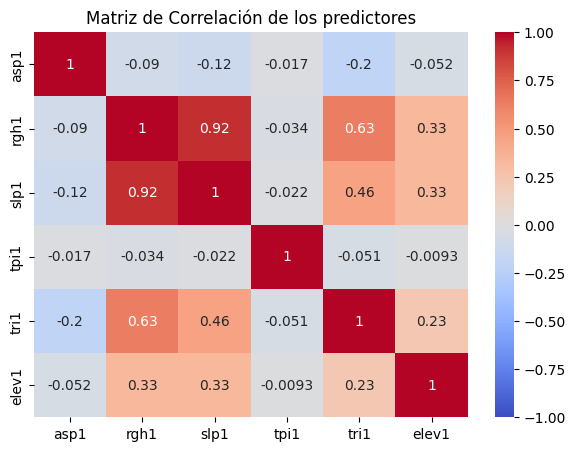

In [7]:
# Calcular matriz de correlación
correlation_matrix = X.corr()
print(correlation_matrix)

# Visualizar matriz de correlación
plt.figure(figsize=(7, 5))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlación de los predictores')
plt.show()

**Step 5. Ajustamos el modelo como baseline**
   - **Ajusta** un modelo de regresión lineal.
   - **Evalúa** el rendimiento del modelo (ejm: `MSE`).

In [9]:
# Dividimos los datos en conjuntos de entrenamiento y prueba
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [11]:
# Instanciamos un modelo de Regresión Lineal y lo ajustamos con los valores de `X_train` y `y_train`
# Creamos una instancia del modelo de regresión lineal
modelo_regresion = LinearRegression()

# Ajustamos el modelo a los datos de entrenamiento
modelo_regresion.fit(X_train, y_train)

,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


In [12]:
# Obtenemos los coeficientes del modelo
coeficientes = modelo_regresion.coef_
# Obtenemos el intercepto 
intercepto = modelo_regresion.intercept_

# Imprimimos coeficientes e intercepto
print(coeficientes, intercepto)

# Definimos la ecuación de la recta de regresión
ecuacion_recta = 'y = ' + ' + '.join([f'{coeficientes[i]}*X{i}' for i in range(len(coeficientes))]) + f' + {intercepto}'
print(f'Ecuación de la recta de regresión: {ecuacion_recta}')

[-6.00389976e-03 -9.50081199e-03 -8.92668120e-02  1.45844363e+00
  1.83096174e-01  6.42400935e-04] 2.2544957230039744
Ecuación de la recta de regresión: y = -0.006003899763952534*X0 + -0.009500811991926553*X1 + -0.08926681198535044*X2 + 1.458443630580392*X3 + 0.18309617442556023*X4 + 0.0006424009345539251*X5 + 2.2544957230039744


  Variable  Coeficiente  Abs_Coeficiente
3     tpi1     1.458444         1.458444
4     tri1     0.183096         0.183096
2     slp1    -0.089267         0.089267
1     rgh1    -0.009501         0.009501
0     asp1    -0.006004         0.006004
5    elev1     0.000642         0.000642


C:\Users\User\AppData\Local\Temp\ipykernel_20020\1682869153.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Coeficiente', y='Variable', data=coef_df, palette='coolwarm')


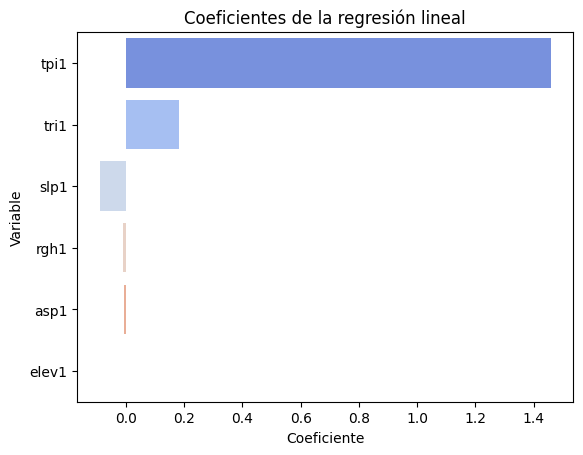

In [13]:
# Crear un DataFrame para facilitar la interpretación
coef_df = pd.DataFrame({'Variable': X.columns, 'Coeficiente': coeficientes})

# Ordenar por el valor absoluto del coeficiente para ver cuáles son más importantes
coef_df['Abs_Coeficiente'] = coef_df['Coeficiente'].abs()

# Ordenamos los coeficientes de mayor a menor
coef_df = coef_df.sort_values(by='Abs_Coeficiente', ascending=False)

print(coef_df)

# Graficamos los coeficientes ordenados de mayor a menor en un gráfico de barras
sns.barplot(x='Coeficiente', y='Variable', data=coef_df, palette='coolwarm')

plt.xlabel('Coeficiente')
plt.ylabel('Variable')
plt.title('Coeficientes de la regresión lineal')
plt.show()

**Step 6. Contribucion relativa de las variables predictoras mediante modelo SHARP**
   - (Opcional) Usa la librería [SHAP](https://shap.readthedocs.io/en/latest/) para **explicar** de manera gráfica la salida del modelo (por ejemplo, puedes crear un objeto `explainer` con el modelo y los datos de entrenamiento, y calcular los valores SHAP).

Note: you may need to restart the kernel to use updated packages.


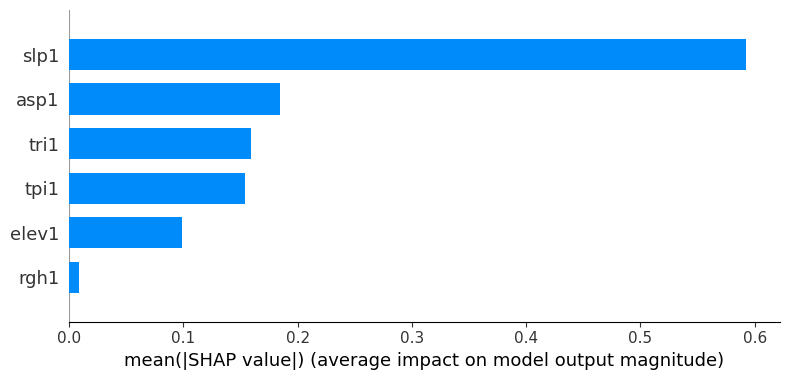

In [14]:
# Instala SHAP
%pip install shap

# Importa SHAP
import shap 

# Crea un objeto explainer con el modelo y los datos de entrenamiento
explainer = shap.Explainer(modelo_regresion, X_train)

# Calcula los valores SHAP para todos los datos de prueba
shap_values = explainer(X_test)

# Grafica los valores SHAP
shap.summary_plot(shap_values, X_test, plot_type='bar')

## Grafica los valores SHAP para un punto de datos específico
## Inicializa los gráficos interactivos
shap.initjs()

# Grafica la contribución de cada variable para la primera fila
shap.force_plot(
    explainer.expected_value,
    shap_values.values[0],   # usar .values para convertir SHAP object a array
    X_test.iloc[0]
)

In [15]:
# Eliminamos la variable que menos aporta y que tiene un alata depedencia entre si
X = X.drop(['rgh1'], axis=1)
X.head(5)

,asp1,slp1,tpi1,tri1,elev1
0,0.109970,20.886478,-0.075195,1.031517,4861.926758
1,350.337708,20.204298,-0.185059,0.905296,4861.905273
2,343.757568,19.912228,-0.005859,0.305124,4862.399414
3,335.548126,20.086668,-0.081055,0.596693,4862.826172
4,346.701843,16.271687,0.032715,0.829091,4863.404297


In [17]:
from sklearn.preprocessing import StandardScaler

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 3. Escalar SOLO con entrenamiento
scaler = StandardScaler()
# El escalador aprende de las caracteristicas de X_train.
# El X_test se transforma con los mismos factores de X_train manteniendo las caracteristicas
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [25]:
# Creamos una instancia del modelo de regresión lineal
modelo_regresion = LinearRegression()

# Ajustamos el modelo a los datos de entrenamiento
modelo_regresion.fit(X_train_scaled, y_train)

,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


In [26]:
# Obtenemos los coeficientes del modelo
coeficientes = modelo_regresion.coef_
# Obtenemos el intercepto 
intercepto = modelo_regresion.intercept_

# Imprimimos coeficientes e intercepto
print(coeficientes, intercepto)

# Definimos la ecuación de la recta de regresión
ecuacion_recta = 'y = ' + ' + '.join([f'{coeficientes[i]}*X{i}' for i in range(len(coeficientes))]) + f' + {intercepto}'
print(f'Ecuación de la recta de regresión: {ecuacion_recta}')

[-0.29160042 -0.78310596  0.33281607  0.27832457  0.12081876] 1.1804317057284412
Ecuación de la recta de regresión: y = -0.29160042318617885*X0 + -0.7831059645303692*X1 + 0.33281606518082807*X2 + 0.2783245689560943*X3 + 0.12081875911772214*X4 + 1.1804317057284412


  Variable  Coeficiente  Abs_Coeficiente
1     slp1    -0.783106         0.783106
2     tpi1     0.332816         0.332816
0     asp1    -0.291600         0.291600
3     tri1     0.278325         0.278325
4    elev1     0.120819         0.120819


C:\Users\User\AppData\Local\Temp\ipykernel_20020\1682869153.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Coeficiente', y='Variable', data=coef_df, palette='coolwarm')


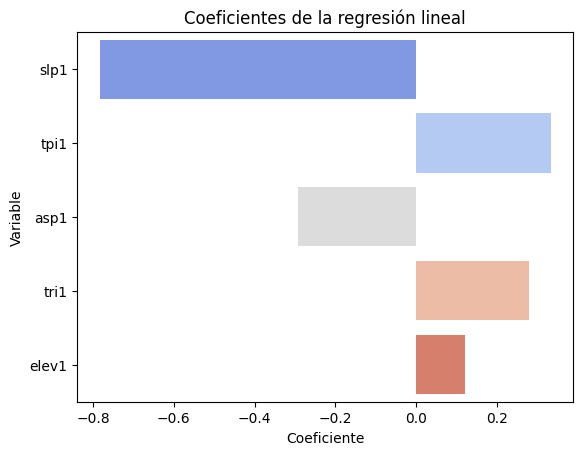

In [27]:
# Crear un DataFrame para facilitar la interpretación
coef_df = pd.DataFrame({'Variable': X.columns, 'Coeficiente': coeficientes})

# Ordenar por el valor absoluto del coeficiente para ver cuáles son más importantes
coef_df['Abs_Coeficiente'] = coef_df['Coeficiente'].abs()

# Ordenamos los coeficientes de mayor a menor
coef_df = coef_df.sort_values(by='Abs_Coeficiente', ascending=False)

print(coef_df)

# Graficamos los coeficientes ordenados de mayor a menor en un gráfico de barras
sns.barplot(x='Coeficiente', y='Variable', data=coef_df, palette='coolwarm')

plt.xlabel('Coeficiente')
plt.ylabel('Variable')
plt.title('Coeficientes de la regresión lineal')
plt.show()

### **Contribucion relativa de las variables predictoras mediante modelo SHARP:**
   - (Opcional) Usa la librería [SHAP](https://shap.readthedocs.io/en/latest/) para **explicar** de manera gráfica la salida del modelo (por ejemplo, puedes crear un objeto `explainer` con el modelo y los datos de entrenamiento, y calcular los valores SHAP).

Note: you may need to restart the kernel to use updated packages.


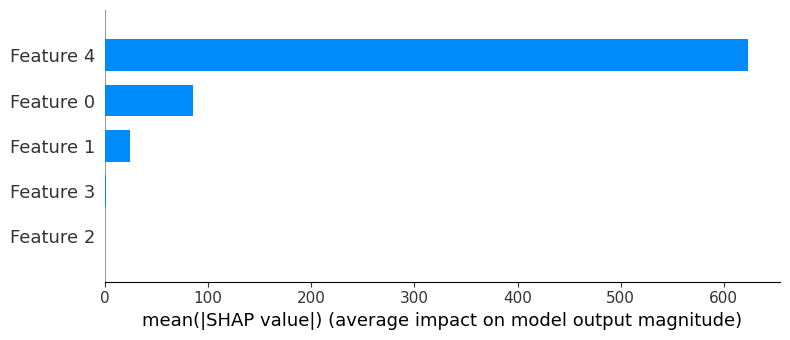

In [ ]:
# Instala SHAP
%pip install shap

# Importa SHAP
import shap 

# Crea un objeto explainer con el modelo y los datos de entrenamiento
explainer = shap.Explainer(modelo_regresion, X_train)

# Calcula los valores SHAP para todos los datos de prueba
shap_values = explainer(X_test_scaled)

# Grafica los valores SHAP
shap.summary_plot(shap_values, X_test_scaled, plot_type='bar')

## Grafica los valores SHAP para un punto de datos específico
## Inicializa los gráficos interactivos
shap.initjs()

# Grafica la contribución de cada variable para la primera fila
shap.force_plot(
    explainer.expected_value,
    shap_values.values[0],   # usar .values para convertir SHAP object a array
    X_test.iloc[0]
)

In [29]:
# Realizamos predicciones sobre el conjunto de prueba
y_pred = modelo_regresion.predict(X_test_scaled)

# Importamos las métricas para evaluar el modelo
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, root_mean_squared_error

# Calculamos las métricas de evaluación
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred) # # Varianza explicada (R^2) en los datos de entrenamiento
mae = mean_absolute_error(y_test, y_pred)
rmse = root_mean_squared_error(y_test, y_pred)

# Imprimimos las métricas de evaluación
print(f'Error Cuadrático Medio (MSE): {mse}')
print(f'Coeficiente de Determinación (R^2): {r2}')
print(f'Error Absoluto Medio (MAE): {mae}')
print(f'Raíz del error cuadrático medio (RMSE): {rmse}')

Error Cuadrático Medio (MSE): 8.674495586828417
Coeficiente de Determinación (R^2): 0.07373069241293118
Error Absoluto Medio (MAE): 2.0717954261916236
Raíz del error cuadrático medio (RMSE): 2.9452496646003405


   
3. **Predicción de Nuevos Registros:**
   - Utiliza el modelo ajustado para **predecir** el valor de `y` de un nuevo registro.

In [31]:
X_train_scaled

array([[-1.04731262e+00, -1.00475265e-01, -1.54309210e-01,
        -4.62720297e-01,  1.02826044e+00],
       [ 2.40183919e-01, -9.57886144e-01, -1.35051654e-01,
        -4.98319966e-01, -1.11533969e+00],
       [-5.93035181e-01, -8.90326678e-01, -4.09035987e-02,
        -3.36323292e-01, -1.02848039e+00],
       ...,
       [ 6.95141879e-01, -6.35739195e-01,  1.05891686e+00,
         4.30450406e-01, -5.26364307e-01],
       [ 1.10684225e+00,  7.43086477e-01,  2.13724095e-01,
        -4.41925736e-01, -1.21415005e+00],
       [ 2.12995992e-01, -1.29546398e-01, -3.38325863e-01,
        -2.39427084e-04, -1.58143771e-01]])

In [32]:
# Definimos un nuevo caso de prueba con los siguientes valores
nuevo_caso = pd.DataFrame({
    'asp1': [-1.25],  # Orientacion
    'slp1': [0.48],  # Pendiente
    'tpi1': [-0.25],  # Índice de posición topográfica
    'tri1': [0.45],  # Índice de Rugosidad del Terreno
    'elev1': [1.02],  # Región noreste
})

# Realizamos la predicción con el nuevo caso de prueba
prediccion = modelo_regresion.predict(nuevo_caso)

# Imprimimos el resultado de la predicción
print(f'El valor de Dh estimado es: {prediccion[0]:.2f} m')


El valor de Dh estimado es: 1.33 m


d:\Maestria_AI\.venv\Lib\site-packages\sklearn\utils\validation.py:2742: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


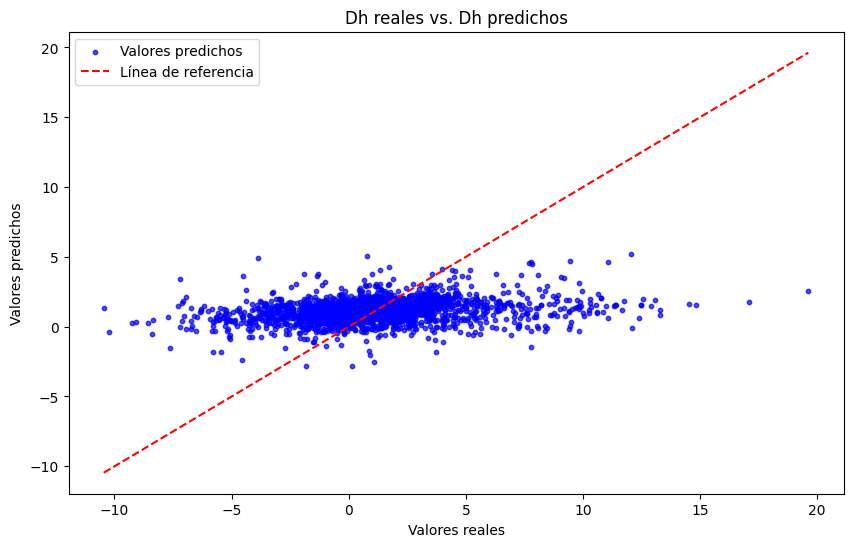

In [39]:
# Graficamos los valores reales vs los valores predichos
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.7, s=10)
plt.title('Dh reales vs. Dh predichos')
plt.xlabel('Valores reales')
plt.ylabel('Valores predichos')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--')  # Línea de referencia
plt.legend(['Valores predichos', 'Línea de referencia'])
plt.show()

### **Análisis del mejor ajuste:**
- (Opcional) Usa [`cross_val_score`](https://scikit-learn.org/stable/modules/cross_validation.html) con 5 folds. Calcula la media del MSE y la desviación estándar de todos los scores obtenidos con la validación cruzada (opcional).